In [1]:
import pandas as pd
import geopandas as gpd

In [86]:
#api to give state and date wise category of data
link = "https://api.covid19india.org/states_daily.json"

In [3]:
import urllib.request as ur
import json
#from pandas import json_normalize
from pandas.io.json import json_normalize
import pandas as pd

In [227]:
response = ur.urlopen(link)
data = json.loads(response.read())

In [228]:
confirmed_index = [i for i in range(len(data.get('states_daily'))) if 'Confirmed' in data.get('states_daily')[i].values()]

In [229]:
recovered_index = [i for i in range(len(data.get('states_daily'))) if 'Recovered' in data.get('states_daily')[i].values()]

In [230]:
deceased_index = [i for i in range(len(data.get('states_daily'))) if 'Deceased' in data.get('states_daily')[i].values()]

In [231]:
lst = [[key,data.get('states_daily')[0].get(key)] for key in data.get('states_daily')[0].keys() if key not in ['date','status']]

In [232]:
temp_df = pd.DataFrame(data=lst,columns=["state_code","case_count"])


In [235]:
final_df = pd.DataFrame()
for c in confirmed_index:
    lst = [[key,data.get('states_daily')[c].get(key)] for key in data.get('states_daily')[c].keys() if key not in ['date','status']]
    temp_df = pd.DataFrame(data=lst,columns=["state_code","case_count"])
    data_date = data.get('states_daily')[c].get('date')
    temp_df['date'] = data_date
    temp_df['status'] = 'confirmed'
    final_df = final_df.append(temp_df,ignore_index = True)
#     print("date done",data_date)

In [236]:
for c in recovered_index:
    lst = [[key,data.get('states_daily')[c].get(key)] for key in data.get('states_daily')[c].keys() if key not in ['date','status']]
    temp_df = pd.DataFrame(data=lst,columns=["state_code","case_count"])
    data_date = data.get('states_daily')[c].get('date')
    temp_df['date'] = data_date
    temp_df['status'] = 'recovered'
    final_df = final_df.append(temp_df,ignore_index = True)
#     print("date done",data_date)

In [237]:
for c in deceased_index:
    lst = [[key,data.get('states_daily')[c].get(key)] for key in data.get('states_daily')[c].keys() if key not in ['date','status']]
    temp_df = pd.DataFrame(data=lst,columns=["state_code","case_count"])
    data_date = data.get('states_daily')[c].get('date')
    temp_df['date'] = data_date
    temp_df['status'] = 'deceased'
    final_df = final_df.append(temp_df,ignore_index = True)
#     print("date done",data_date)

In [273]:
final_df['case_count'] = final_df['case_count'].astype(int)

In [274]:
#data to study the confirmed cases time series and predict the downfall
final_df_copy = final_df.copy()

In [275]:
final_df_copy['date'] = pd.to_datetime(final_df_copy['date'],format="%d-%b-%y")

In [289]:
final_df_to_plot = final_df_copy[final_df_copy['state_code'] == 'tt']

In [337]:
final_df_tt_confirmed = final_df_copy[(final_df_copy['status'] == 'confirmed') & (final_df_copy['state_code'] == 'tt')].copy()

In [338]:
final_df_tt_recovered = final_df_copy[(final_df_copy['status'] == 'recovered') & (final_df_copy['state_code'] == 'tt')].copy()

In [339]:
final_df_tt_death = final_df_copy[(final_df_copy['status'] == 'deceased') & (final_df_copy['state_code'] == 'tt')].copy()

In [241]:
import plotly.express as px

In [298]:
fig = px.line(final_df_to_plot, x='date', y='case_count',color='status',color_discrete_sequence=["red","green","grey"])
fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [243]:
# reading the geometry file
states = gpd.read_file('IND_adm/states-final.shp')

In [244]:
import datetime

In [245]:
final_df_yest = final_df_copy[(final_df_copy.date == datetime.datetime(2020,6,19,0,0,0)) & (final_df_copy.status == "confirmed")]

In [246]:
# filter the total cases, as it skew the scale and goes to the data for mapping 
final_df_yest = final_df_yest[~(final_df_yest.state_code.isin(['tt','un']))]

In [247]:
# for mapping with matplitlib
states_join = states.merge(final_df_yest,on = "state_code")

In [248]:
states_join['case_count'] = states_join['case_count'].astype(int)

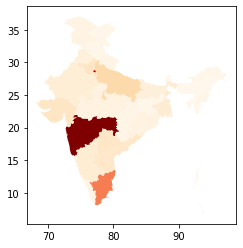

In [249]:
import matplotlib.pyplot as plt
# fig, ax = plt.subplots(1, 1)
# states_join.plot(column='case_count', ax=ax, legend=True)
states_join.plot(column='case_count',cmap='OrRd');

# Mapping with Folium

In [146]:
import os
import folium

In [147]:
import json
import requests

In [250]:
import json
#reading the geometry file as a json object
with open('IND_adm/states-final.geojson') as json_file:
    states_geom = json.load(json_file)

In [251]:
# adding count of cases to the geom file for hover pop up
for i in range(len(states_geom.get('features'))):
    states_geom['features'][i]['properties']['case_count'] = int(final_df_yest[final_df_yest.state_code == states_geom.get('features')[i].get('properties').get('state_code')].case_count)
   

In [257]:
final_df_yest['case_count'] = final_df_yest['case_count'].astype(int)

In [260]:
m = folium.Map(width=900,height=700,location = [20, 78], zoom_start=5)

choropleth = folium.Choropleth(
    geo_data=states_geom,
    data=final_df_yest,
    columns=['state_code', 'case_count'],
    key_on='feature.properties.state_code',
    fill_color='YlOrRd',
    name='covid cases',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Number of Cases',
    highlight=True
#     show=False,
).add_to(m)

# The underlying GeoJson and StepColormap objects are reachable
# print(type(choropleth.geojson))
# print(type(choropleth.color_scale))

folium.LayerControl(collapsed=False).add_to(m)
choropleth.geojson.add_child(folium.features.GeoJsonTooltip(['case_count'],labels=False))

m

In [162]:
#sample Mapping data from folium documentation
url = 'https://raw.githubusercontent.com/python-visualization/folium/master/examples/data'
state_geo = f'{url}/us-states.json'
state_unemployment = f'{url}/US_Unemployment_Oct2012.csv'
state_data = pd.read_csv(state_unemployment)

In [167]:
import json
import requests


url = 'https://raw.githubusercontent.com/python-visualization/folium/master/examples/data'
us_states = f'{url}/us-states.json'

geo_json_data = json.loads(requests.get(us_states).text)

In [168]:
m = folium.Map(location=[48, -102], zoom_start=3)

folium.Choropleth(
    geo_data=geo_json_data,
    name='choropleth',
    data=state_data,
    columns=['State', 'Unemployment'],
    key_on='feature.id',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Unemployment Rate (%)'
).add_to(m)

folium.LayerControl().add_to(m)

m

In [340]:
# data preperation for correlation between confirmed, deceased and recovered cases, and lockdown effects

# final_df_tt_confirmed.head()
# final_df_tt_recovered.head()
# final_df_tt_death.head()

# final_df_tt_confirmed.rename(columns={"case_count":"confirmed"},inplace=True)
# final_df_tt_recovered.rename(columns={"case_count":"recovered"},inplace=True)
# final_df_tt_death.rename(columns={"case_count":"deceased"},inplace=True)

final_df_tt_confirmed = final_df_tt_confirmed.reset_index()
final_df_tt_recovered =final_df_tt_recovered.reset_index()
final_df_tt_death = final_df_tt_death.reset_index()

final_df_merged = final_df_tt_confirmed.drop(["status"],axis=1)

In [341]:
final_df_merged['recovered']=final_df_tt_recovered.case_count
final_df_merged['deceased']=final_df_tt_death.case_count

In [343]:
final_df_merged.drop(["index"],axis=1,inplace=True)

In [344]:
final_df_merged = pd.to_datetime(final_df_merged['date'],format="%d-%b-%y")

,state_code,case_count,date,recovered,deceased
0,tt,81,2020-03-14,9,2
1,tt,27,2020-03-15,4,0
2,tt,15,2020-03-16,1,0
3,tt,11,2020-03-17,1,1
4,tt,37,2020-03-18,0,0


In [358]:
# link for daily testing state wise
testing_data_link = "https://api.covid19india.org/state_test_data.json"
total_time_series = "https://api.covid19india.org/data.json"

In [346]:
test_response = ur.urlopen(testing_data_link)
test_data_statewise = json.loads(test_response.read())

In [353]:
test_data = pd.json_normalize(test_data_statewise['states_tested_data'])

In [354]:
test_data.columns

Index(['coronaenquirycalls', 'cumulativepeopleinquarantine', 'negative',
       'numcallsstatehelpline', 'numicubeds', 'numisolationbeds',
       'numventilators', 'peopleinicu', 'peopleonventilators',
       'populationncp2019projection', 'positive', 'source1', 'source2',
       'state', 'tagpeopleinquarantine', 'tagtotaltested',
       'testpositivityrate', 'testspermillion', 'testsperpositivecase',
       'testsperthousand', 'totaln95masks', 'totalpeoplecurrentlyinquarantine',
       'totalpeoplereleasedfromquarantine', 'totalppe', 'totaltested',
       'unconfirmed', 'updatedon', '_d5fpr'],
      dtype='object')

In [355]:
test_data = test_data[['updatedon','totaltested','state','negative','testsperpositivecase','testsperthousand', 'totaln95masks','unconfirmed']]

In [359]:
time_series_response = ur.urlopen(total_time_series)
time_series_national = json.loads(time_series_response.read())

In [363]:
time_series_national.keys()

dict_keys(['cases_time_series', 'statewise', 'tested'])

In [361]:
time_series = pd.json_normalize(time_series_national['cases_time_series'])

In [364]:
tested_time_series = pd.json_normalize(time_series_national['tested'])

In [378]:
tested_time_series.tail()

,individualstestedperconfirmedcase,positivecasesfromsamplesreported,samplereportedtoday,source,testpositivityrate,testsconductedbyprivatelabs,testsperconfirmedcase,testspermillion,totalindividualstested,totalpositivecases,totalsamplestested,updatetimestamp
98,,,163187,https://t.me/Covid19india_Auxiliary_Test_Data/509,,,,4565,,,6084256,17/06/2020 09:00:00
99,,,165412,https://t.me/Covid19india_Auxiliary_Test_Data/525,,,,4689,,,6249668,18/06/2020 09:00:00
100,,,176959,https://t.me/Covid19india_Auxiliary_Test_Data/543,,,,,,,6426627,19/06/2020 09:00:00
101,,,189869,https://t.me/Covid19india_Auxiliary_Test_Data/562,,,,,,,6616496,20/06/2020 09:00:00
102,,,190730,https://t.me/Covid19india_Auxiliary_Test_Data/577,,,,,,,6807226,21/06/2020 09:00:00


In [372]:
import plotly.graph_objects as go


In [376]:
# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=time_series.date, y=time_series.totalconfirmed,
                    name='total confirmed',
                    line=dict(color='firebrick', width=2)))
fig.add_trace(go.Scatter(x=time_series.date, y=time_series.totalrecovered,
                    name='total recovered',
                    line=dict(color='green', width=2)))
fig.add_trace(go.Scatter(x=time_series.date, y=time_series.totaldeceased,
                    name='total deceased',
                    line=dict(color='grey', width=1)))
fig.show()